# Mintun1984AndArtery for Image-Derived Input Functions and Twilite Data
## Setup

In [1]:
# system functions that are always useful to have
import time, sys, os
from pprint import pprint

# basic numeric setup
import numpy as np

from Boxcar import Boxcar
from RadialArtery import RadialArtery
from Mintun1984ModelAndArtery import Mintun1984ModelAndArtery

In [2]:
# define data & models
petdir = os.path.join(os.getenv("HOME"), "PycharmProjects", "dynesty", "idif2024", "data", "ses-20210421150523", "pet")
idif = os.path.join(petdir, "sub-108293_ses-20210421150523_trc-oo_proc-MipIdif_idif.nii.gz")
twil = os.path.join(petdir, "sub-108293_ses-20210421150523_trc-oo_proc-TwiliteKit-do-make-input-func-nomodel_inputfunc.nii.gz")
kern = os.path.join(petdir, "kernel_hct=46.8.nii.gz")
pet = os.path.join(petdir, "sub-108293_ses-20210421150523_trc-oo_proc-delay0-BrainMoCo2-createNiftiMovingAvgFrames-ParcSchaeffer-reshape-to-schaeffer-2parcs.nii.gz")  # 1st two Schaeffer parcels
tcm_bc = Mintun1984ModelAndArtery(
    idif, 
    pet,
    truths=[
       13.8, 12.3, 53.9,
       0.668, 7.66, 1.96, -1.38, -0.023, 60.0,
       0.074, 0.027, 0.014, 
       2.427,
       0.008,
       0.511, 0.245, 0.775, 5, -5, 0.029],
    nlive=100)
tcm_ra = Mintun1984ModelAndArtery(
    twil, 
    pet,
    truths=[
       11.484636938903700, 9.038382807893550, 28.568246786745600,
       4.5866245255678400, 11.95532505177820, 2.566526335309770, -4.459469081789230, -6.0112371284438400, 25.2540519845093, 
       0.020278321953784300, 0.008119846365675890, 0.07320044514638420,
       2.442656141915740, 
       0.02215511898025070,
       0.511, 0.245, 0.775, 5, -5, 0.029],
    nlive=100)

Boxcar: found data for tracer oo
{'fqfp': '/Users/jjlee/PycharmProjects/dynesty/idif2024/data/ses-20210421150523/pet/sub-108293_ses-20210421150523_trc-oo_proc-MipIdif_idif',
 'halflife': 122.2416,
 'img': array([   918.68947134,    918.68947134,    918.68947134,    918.68947134,
          918.68947134,    918.68947134,   3260.06714251,  14982.71503217,
        37098.87403638,  81749.04713056, 128126.70920003, 168967.1890541 ,
       219084.03287981, 267362.91966016, 310740.04433832, 356920.70792181,
       376137.25845916, 373545.92834164, 373533.18076537, 333167.28960198,
       309823.30646135, 308142.97593833, 291558.92492749, 237257.86160135,
       209933.47427883, 194343.50291959, 179898.26460708, 163739.49416324,
       126034.86965769, 125322.23581555,  95938.06356353,  71293.71609447,
        55401.44796998,  50831.4910168 ]),
 'nii': <nibabel.nifti1.Nifti1Image object at 0x2b90cb610>,
 'taus': array([10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10.,

## Inspect Mintun1984ModelAndArtery with Boxcar

In [ ]:
v = tcm_bc.truths
pprint("===================================== v ======================================")
pprint(v)

data = tcm_bc.data(v)
pprint("==================================== data ====================================")
pprint(data)

In [ ]:
pprint("============================== tcm_bc.data2t(data) ===============================")
pprint(tcm_bc.data2t(data))
pprint("============================= tcm_bc.data2taus(data) =============================")
pprint(tcm_bc.data2taus(data))
pprint("=========================== tcm_bc.data2timesMid(data) ===========================")
pprint(tcm_bc.data2timesMid(data))
pprint("================================== tcm_bc.fqfp ===================================")
pprint(tcm_bc.fqfp)
pprint("========================== tcm_bc.input_function() =========================")
pprint(tcm_bc.input_function())
pprint("================================= tcm_bc.labels ==================================")
pprint(tcm_bc.labels)
pprint("====================== tcm_bc.load_nii(tcm_bc.fqfp + '.nii.gz') ======================")
pprint(tcm_bc.load_nii(tcm_bc.fqfp + ".nii.gz"))
pprint("=============================== tcm_bc.loglike(v) ================================")
pprint(tcm_bc.loglike(v))
pprint("================================== tcm_bc.ndim ===================================")
pprint(tcm_bc.ndim)
pprint("========================= tcm_bc.parse_halflife(tcm_bc.fqfp) =========================")
pprint(tcm_bc.parse_halflife(tcm_bc.fqfp))
pprint("========================= tcm_bc.parse_isotope(tcm_bc.fqfp) ==========================")
pprint(tcm_bc.parse_isotope(tcm_bc.fqfp))
pprint("================================== tcm_bc.sigma ==================================")
pprint(tcm_bc.sigma)
pprint("============================ tcm_bc.signalmodel(data) ============================")
pprint(tcm_bc.signalmodel(data))

## Plot Mintun1984Model with Boxcar

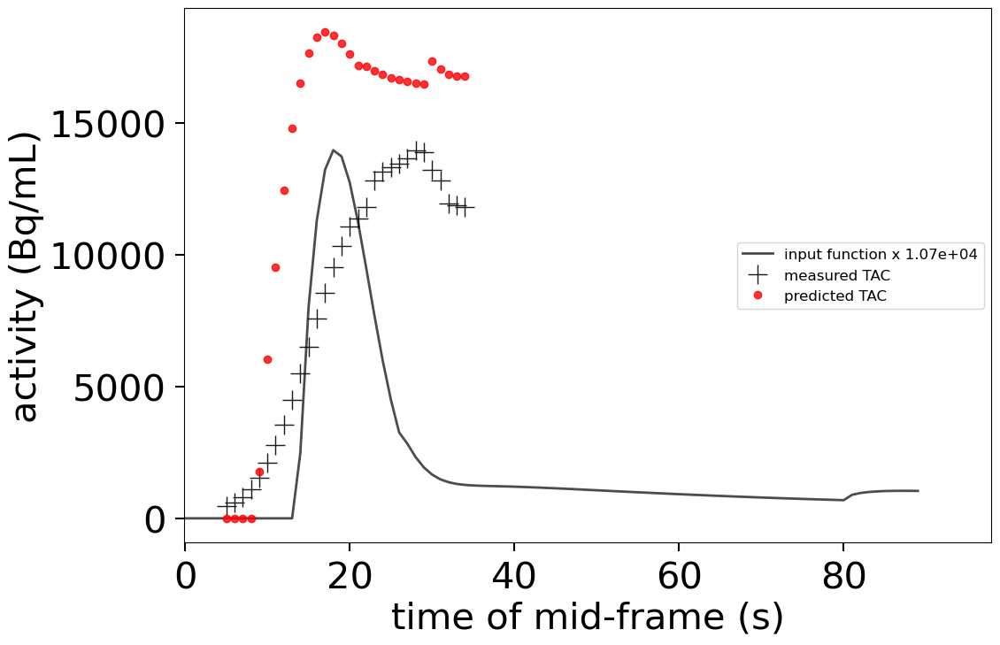

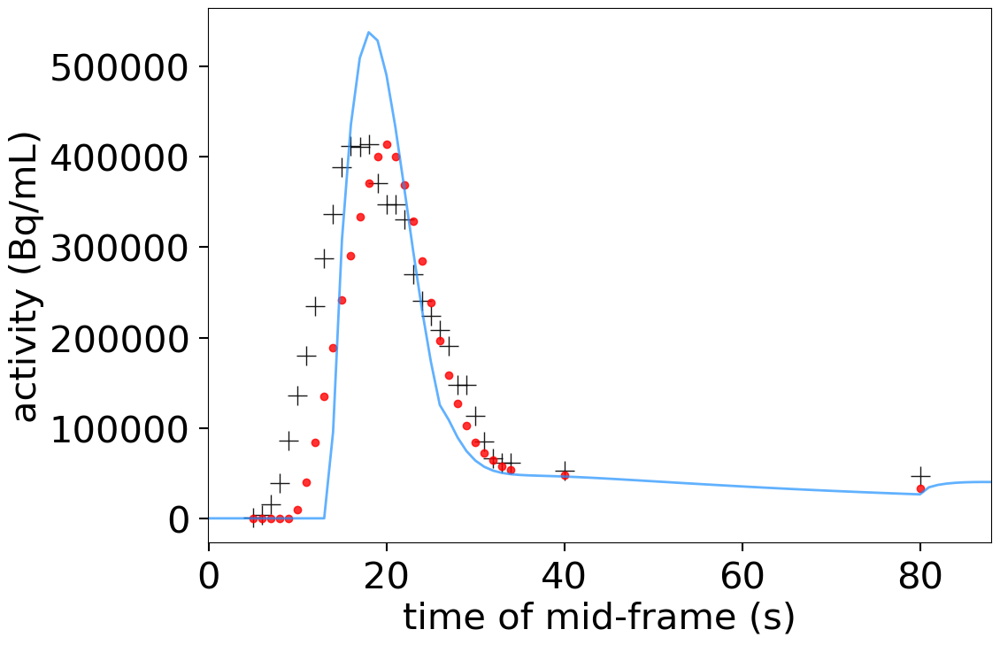

In [9]:
tcm_bc.plot_truths()

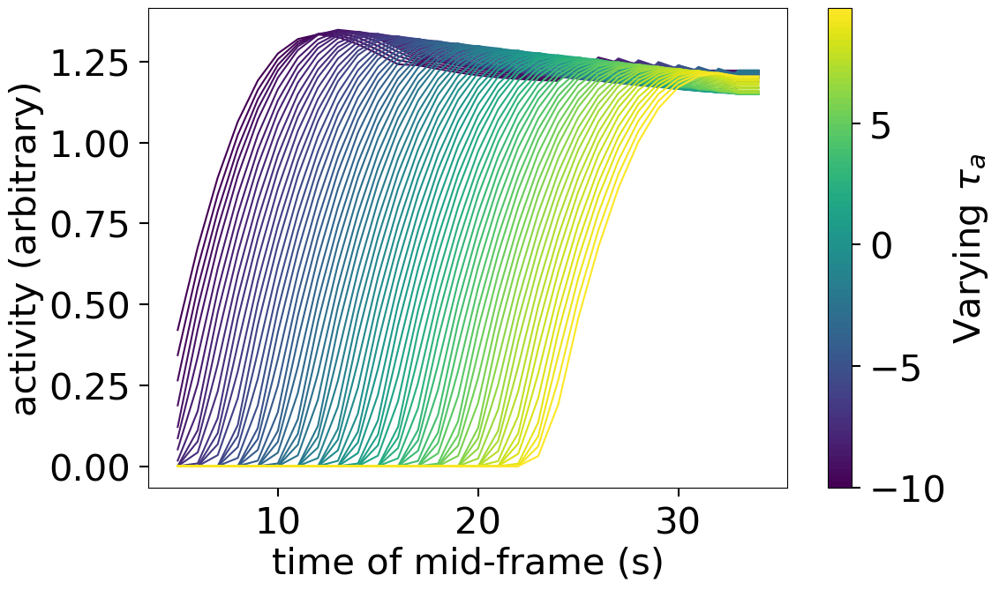

In [10]:
tcm_bc.plot_variations(18, -10, 10 , tcm_bc.truths)

Let's sample from this distribution using the default `dynesty` settings with `'slice'`.

/Users/jjlee/PycharmProjects/dynesty/idif2024/Mintun1984ModelAndArtery.py:93: RuntimeWarning: divide by zero encountered in scalar divide
  y = (n - idx0) / (idxU - idx0)
iter: 14052 | batch: 13 | bound: 23 | nc: 1 | ncall: 1778758 | eff(%):  0.784 | loglstar: 48.955 < 61.645 < 59.449 | logz: 29.345 +/-  0.198 | stop:  0.997                                           

Parameter 0: 1.205 [0.064, 3.801]
Parameter 1: 51.325 [31.401, 59.673]
Parameter 2: 24.716 [3.134, 47.526]
Parameter 3: 2.705 [1.618, 4.032]
Parameter 4: 14.474 [8.976, 19.260]
Parameter 5: 2.122 [1.544, 2.885]
Parameter 6: -5.066 [-9.557, -0.205]
Parameter 7: -4.048 [-9.543, -0.242]
Parameter 8: 137.613 [14.406, 276.039]
Parameter 9: 0.276 [0.251, 0.368]
Parameter 10: 0.085 [0.003, 0.349]
Parameter 11: 0.027 [0.001, 0.098]
Parameter 12: 2.347 [0.644, 4.339]
Parameter 13: 0.096 [0.085, 0.100]
Parameter 14: 0.161 [0.141, 0.191]
Parameter 15: 0.688 [0.404, 0.795]
Parameter 16: 0.967 [0.841, 0.999]
Parameter 17: 8.579 [2.651, 11.264]
Parameter 18: 0.686 [-2.195, 6.494]
Parameter 19: 0.049 [0.045, 0.050]


/Users/jjlee/PycharmProjects/dynesty/idif2024/Mintun1984ModelAndArtery.py:93: RuntimeWarning: divide by zero encountered in scalar divide
  y = (n - idx0) / (idxU - idx0)
iter: 88 | batch: 0 | bound: 0 | nc: 2 | ncall: 172 | eff(%): 32.353 | loglstar:   -inf < -79807.656 <    inf | logz: -79814.057 +/-    nan | dlogz: 79491.917 >  0.010                               

Parameter 0: 1.205 [0.064, 3.801]
Parameter 1: 51.325 [31.401, 59.673]
Parameter 2: 24.716 [3.134, 47.526]
Parameter 3: 2.705 [1.618, 4.032]
Parameter 4: 14.474 [8.976, 19.260]
Parameter 5: 2.122 [1.544, 2.885]
Parameter 6: -5.066 [-9.557, -0.205]
Parameter 7: -4.048 [-9.543, -0.242]
Parameter 8: 137.613 [14.406, 276.039]
Parameter 9: 0.276 [0.251, 0.368]
Parameter 10: 0.085 [0.003, 0.349]
Parameter 11: 0.027 [0.001, 0.098]
Parameter 12: 2.347 [0.644, 4.339]
Parameter 13: 0.096 [0.085, 0.100]
Parameter 14: 0.161 [0.141, 0.191]
Parameter 15: 0.688 [0.404, 0.795]
Parameter 16: 0.967 [0.841, 0.999]
Parameter 17: 8.579 [2.651, 11.264]
Parameter 18: 0.686 [-2.195, 6.494]
Parameter 19: 0.049 [0.045, 0.050]


iter: 16695 | batch: 11 | bound: 56 | nc: 1 | ncall: 2070539 | eff(%):  0.802 | loglstar: 81.467 < 98.699 <    inf | logz: 37.281 +/-  0.329 | stop:  1.062                                           

Parameter 0: 11.588 [11.075, 11.955]
Parameter 1: 8.813 [8.348, 9.312]
Parameter 2: 23.492 [4.662, 57.875]
Parameter 3: 0.153 [0.067, 0.323]
Parameter 4: 7.916 [7.462, 8.449]
Parameter 5: 9.336 [6.856, 10.212]
Parameter 6: -7.371 [-8.459, -5.000]
Parameter 7: -4.380 [-9.600, -0.212]
Parameter 8: 157.827 [19.230, 290.944]
Parameter 9: 0.322 [0.285, 0.351]
Parameter 10: 0.034 [0.002, 0.087]
Parameter 11: 0.060 [0.005, 0.114]
Parameter 12: 2.592 [0.620, 4.379]
Parameter 13: 0.031 [0.023, 0.046]
Parameter 14: 0.729 [0.699, 0.739]
Parameter 15: 0.412 [0.210, 0.762]
Parameter 16: 0.981 [0.921, 0.999]
Parameter 17: 12.532 [11.924, 13.055]
Parameter 18: -15.003 [-15.228, -14.827]
Parameter 19: 0.049 [0.047, 0.050]
Parameter 0: 11.588 [11.075, 11.955]
Parameter 1: 8.813 [8.348, 9.312]
Parameter 2: 23.492 [4.662, 57.875]
Parameter 3: 0.153 [0.067, 0.323]
Parameter 4: 7.916 [7.462, 8.449]
Parameter 5: 9.336 [6.856, 10.212]
Parameter 6: -7.371 [-8.459, -5.000]
Parameter 7: -4.380 [-9.600, -0.212]


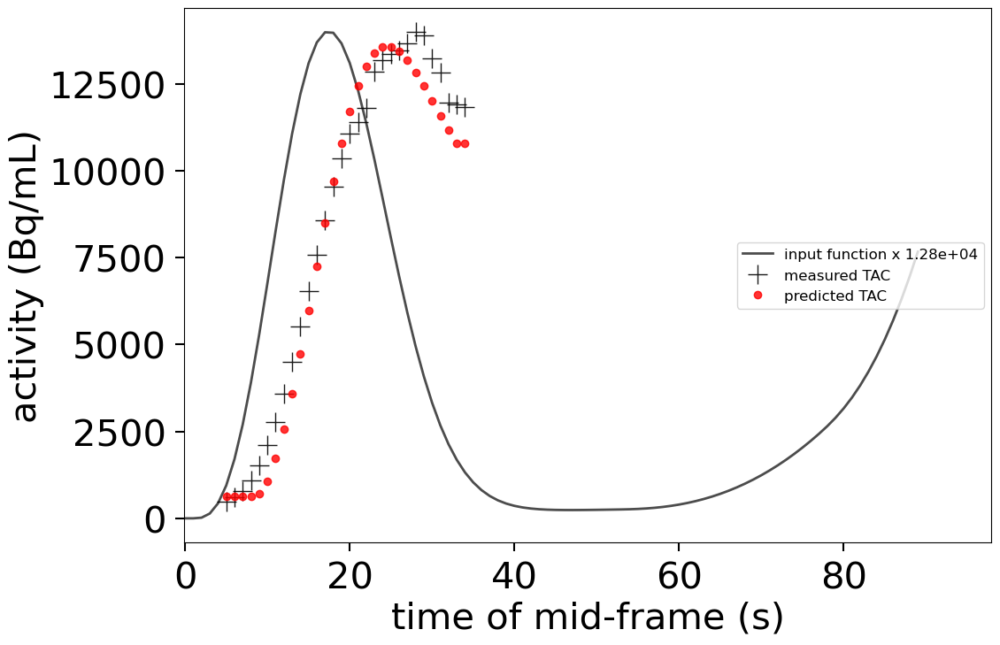

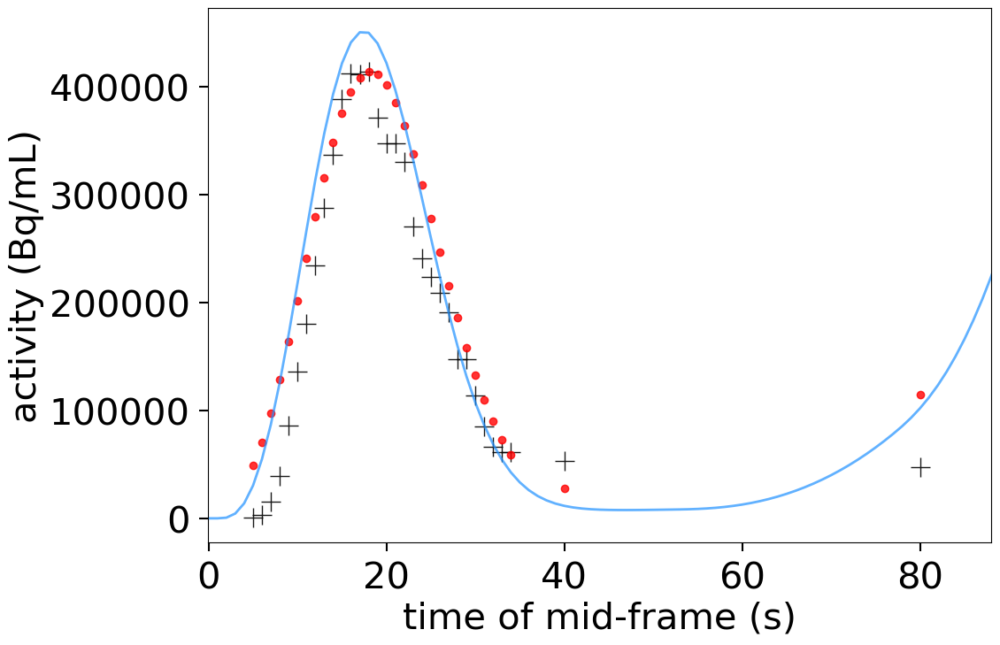

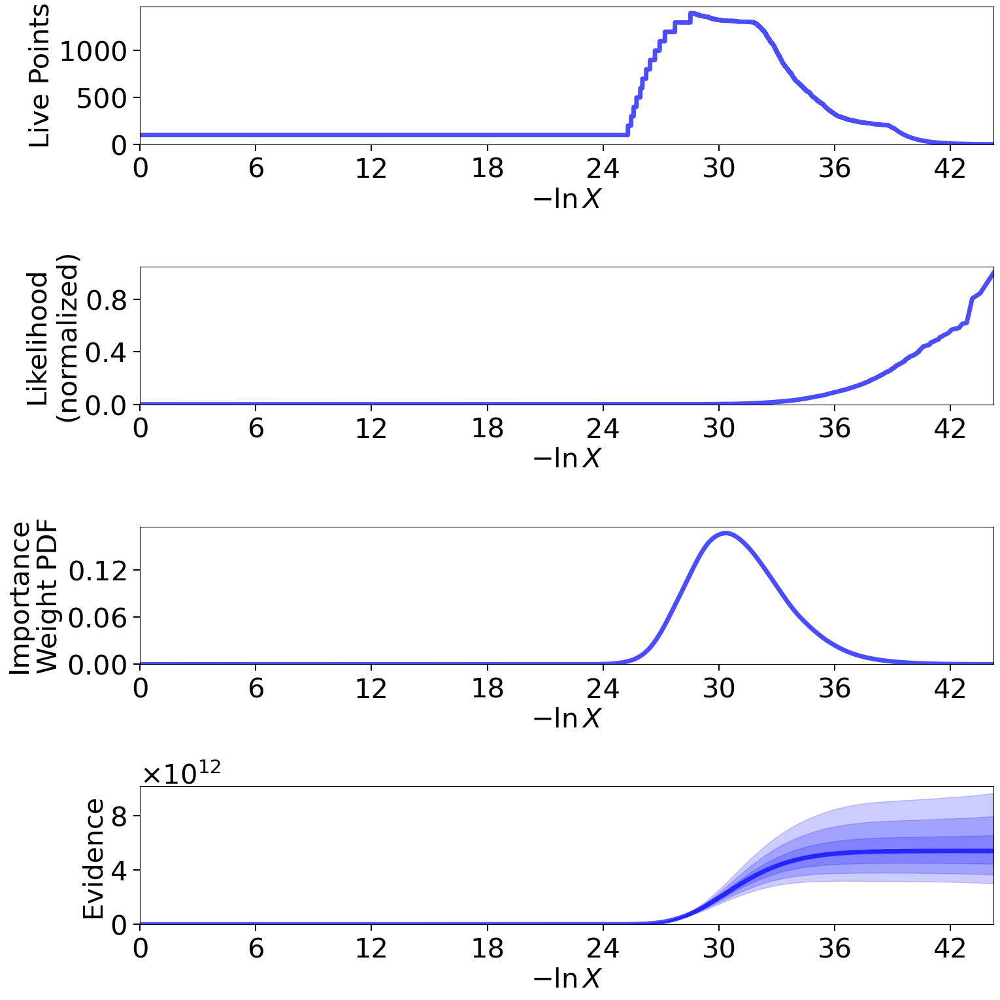

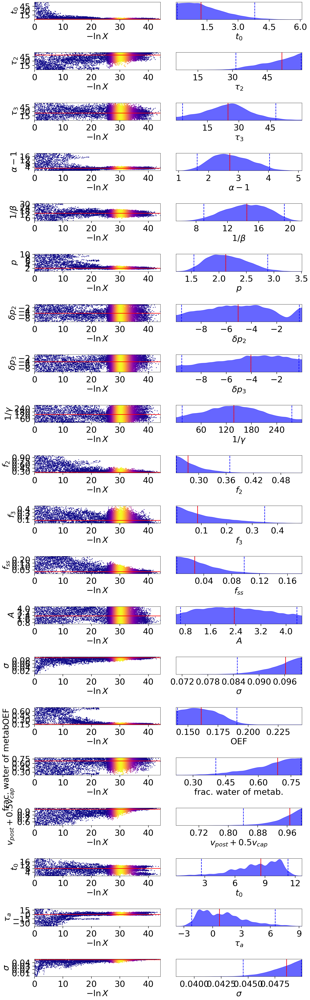

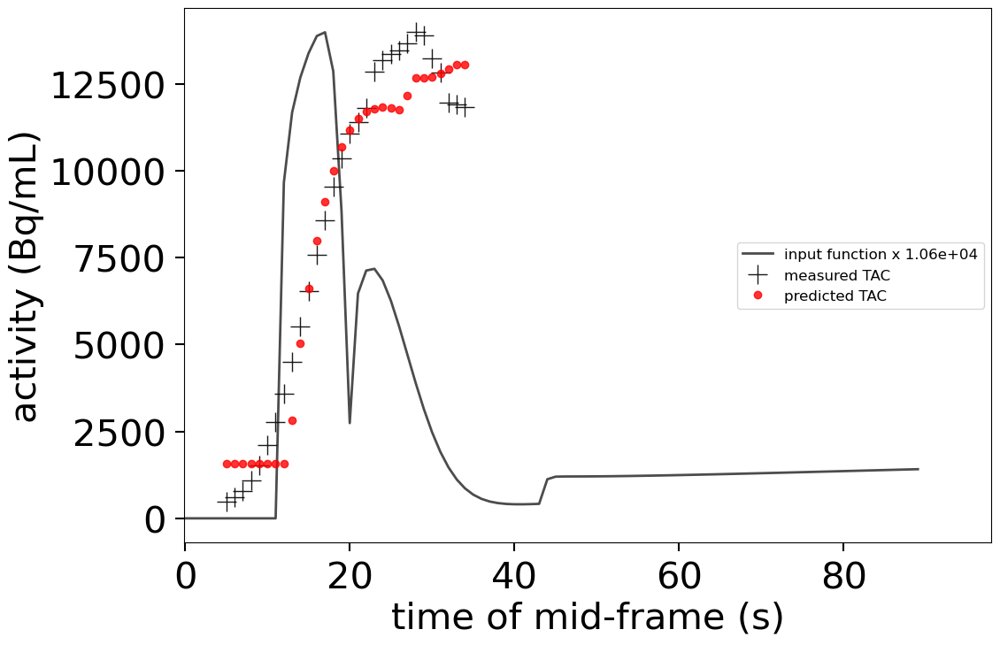

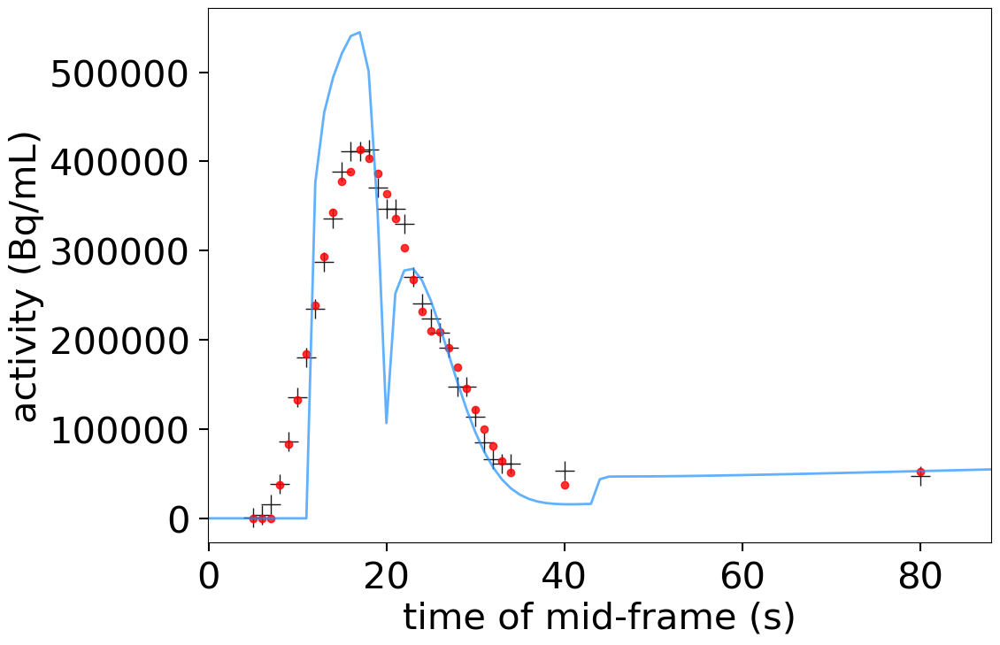

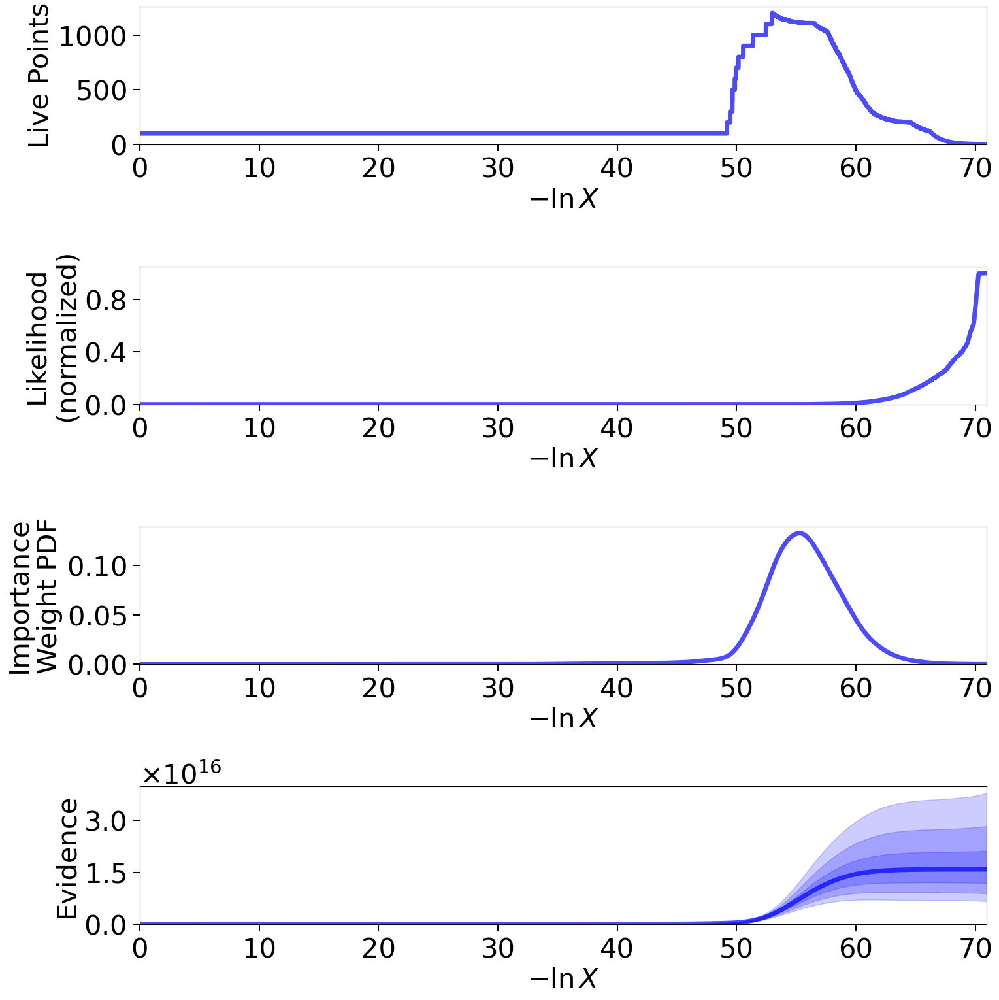

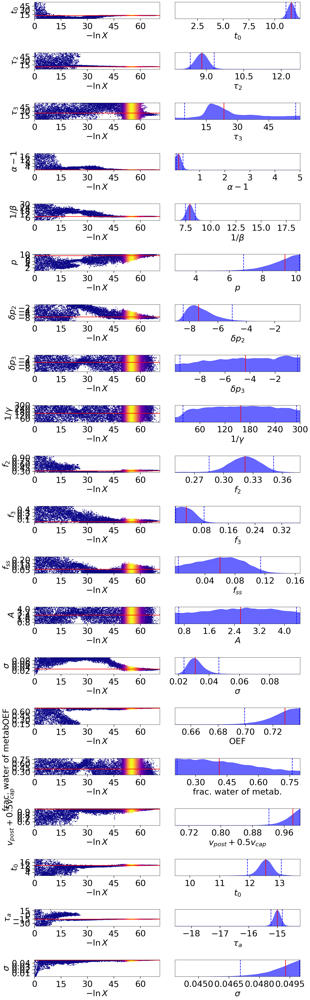

In [11]:
# de novo
res_bc = tcm_bc.run_nested(print_progress=True)

# # restart
# sampler = dynesty.DynamicNestedSampler.restore(tcm_bc.fqfp+"_dynesty-Boxcar-20240122210738.save")
# sampler.run_nested(resume=True, print_progress=True)
# res = sampler.results

## Inspect Mintun1984ModelAndArtery with RadialArtery

In [4]:
v = tcm_ra.truths
pprint("===================================== v ======================================")
pprint(v)

data = tcm_ra.data(v)
pprint("==================================== data ====================================")
pprint(data)

'===================================== v ======================================'
[11.4846369389037,
 9.03838280789355,
 28.5682467867456,
 4.58662452556784,
 11.9553250517782,
 2.56652633530977,
 -4.45946908178923,
 -6.01123712844384,
 25.2540519845093,
 0.0202783219537843,
 0.00811984636567589,
 0.0732004451463842,
 2.44265614191574,
 0.0221551189802507,
 0.511,
 0.245,
 0.775,
 5,
 -5,
 0.029]
'==================================== data ===================================='
{'halflife': 122.2416,
 'inputFuncInterp': array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.08690577,  0.25922404,  0.49677642,
        0.9626305 ,  1.92881211,  3.74522568,  6.76858721, 11.26193983,
       17.28766395, 24.62529956, 32.74514923, 40.85723448, 48.03457446,
       53.38606016, 56.23593191, 56.26155672, 53.55189706, 48.57256106,
       42.05118579, 34.81897042, 27.65293521, 21.15712173, 15.70364271,
        0.13765434,  0.06310922,  0.11139413,

In [5]:
pprint("============================== tcm_ra.data2t(data) ===============================")
pprint(tcm_ra.data2t(data))
pprint("============================= tcm_ra.data2taus(data) =============================")
pprint(tcm_ra.data2taus(data))
pprint("=========================== tcm_ra.data2timesMid(data) ===========================")
pprint(tcm_ra.data2timesMid(data))
pprint("================================== tcm_ra.fqfp ===================================")
pprint(tcm_ra.fqfp)
pprint("========================== tcm_ra.input_function() =========================")
pprint(tcm_ra.input_function())
pprint("================================= tcm_ra.labels ==================================")
pprint(tcm_ra.labels)
pprint("====================== tcm_ra.load_nii(tcm_ra.fqfp + '.nii.gz') ======================")
pprint(tcm_ra.load_nii(tcm_ra.fqfp + ".nii.gz"))
pprint("=============================== tcm_ra.loglike(v) ================================")
pprint(tcm_ra.loglike(v))
pprint("================================== tcm_ra.ndim ===================================")
pprint(tcm_ra.ndim)
pprint("========================= tcm_ra.parse_halflife(tcm_ra.fqfp) =========================")
pprint(tcm_ra.parse_halflife(tcm_ra.fqfp))
pprint("========================= tcm_ra.parse_isotope(tcm_ra.fqfp) ==========================")
pprint(tcm_ra.parse_isotope(tcm_ra.fqfp))
pprint("================================== tcm_ra.sigma ==================================")
pprint(tcm_ra.sigma)
pprint("============================ tcm_ra.signalmodel(data) ============================")
pprint(tcm_ra.signalmodel(data))

('============================== tcm_ra.data2t(data) '
 '===============================')
array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
       26., 27., 28., 29., 30., 31., 32., 33., 34., 35., 36., 37., 38.])
('============================= tcm_ra.data2taus(data) '
 '=============================')
array([10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10., 10., 10., 10.])
('=========================== tcm_ra.data2timesMid(data) '
 '===========================')
array([ 5.,  6.,  7.,  8.,  9., 10., 11., 12., 13., 14., 15., 16., 17.,
       18., 19., 20., 21., 22., 23., 24., 25., 26., 27., 28., 29., 30.,
       31., 32., 33., 34.])
('================================== tcm_ra.fqfp '
 '===================================')
'/Users/jjlee/PycharmProjects/dynesty/idif2024/data/ses-20210421150523/pet/

## Plot Mintun1984Model with RadialArtery

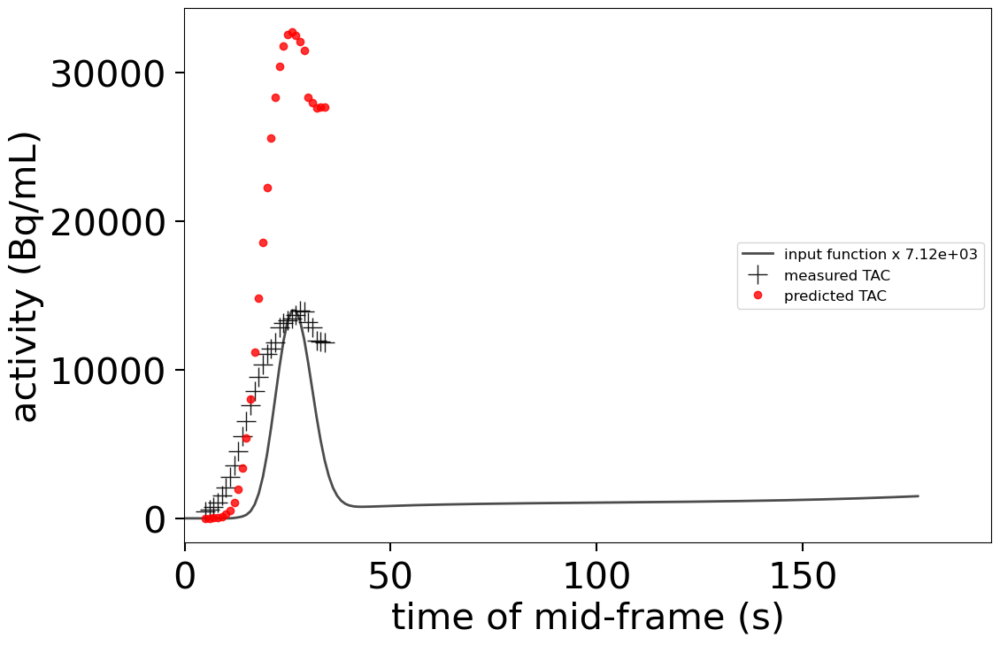

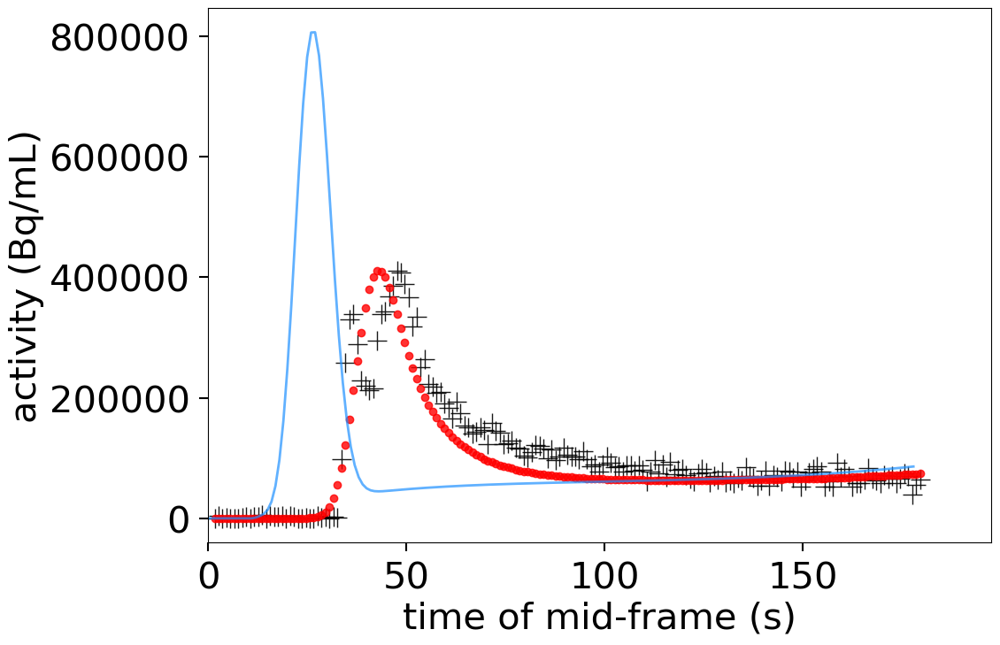

In [6]:
tcm_ra.plot_truths()

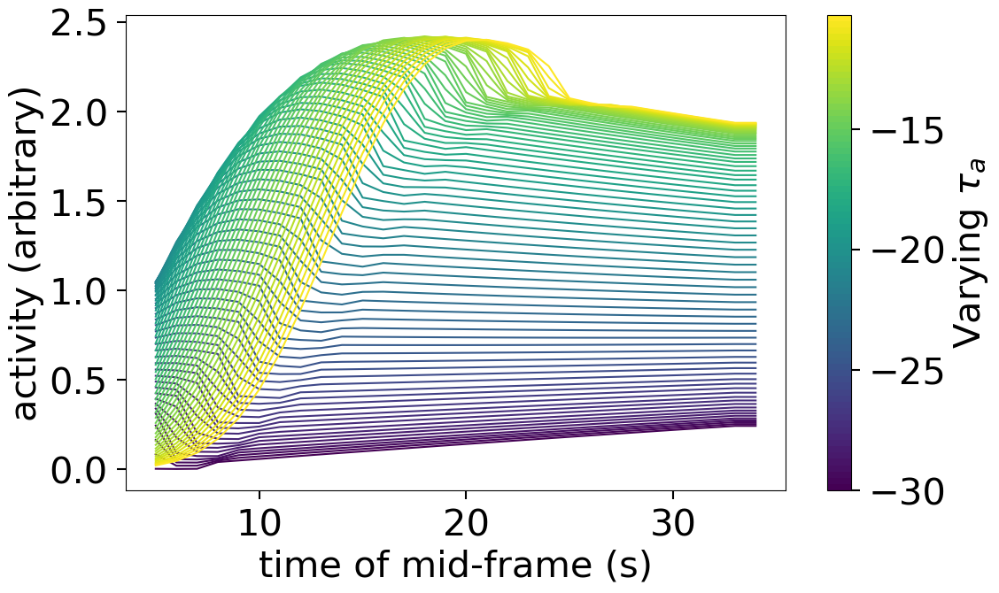

In [7]:
tcm_ra.plot_variations(18, -30, -10 , tcm_ra.truths)

Let's sample from this distribution using the default `dynesty` settings with `'slice'`.

/Users/jjlee/PycharmProjects/dynesty/idif2024/Mintun1984ModelAndArtery.py:93: RuntimeWarning: divide by zero encountered in scalar divide
  y = (n - idx0) / (idxU - idx0)
iter: 16399 | batch: 12 | bound: 37 | nc: 1 | ncall: 2033329 | eff(%):  0.801 | loglstar: 228.529 < 245.065 < 243.140 | logz: 189.361 +/-  0.299 | stop:  0.909                                       

Parameter 0: 8.215 [3.195, 12.708]
Parameter 1: 9.507 [7.721, 11.234]
Parameter 2: 16.284 [1.478, 34.399]
Parameter 3: 11.746 [5.369, 18.525]
Parameter 4: 14.333 [10.792, 18.610]
Parameter 5: 9.373 [7.598, 10.211]
Parameter 6: -4.302 [-5.550, -2.740]
Parameter 7: -2.527 [-4.049, -0.377]
Parameter 8: 14.056 [4.018, 42.229]
Parameter 9: 0.371 [0.337, 0.409]
Parameter 10: 0.023 [0.011, 0.043]
Parameter 11: 0.053 [0.044, 0.063]
Parameter 12: 2.764 [0.668, 4.405]
Parameter 13: 0.052 [0.047, 0.058]
Parameter 14: 0.733 [0.712, 0.740]
Parameter 15: 0.566 [0.236, 0.789]
Parameter 16: 0.995 [0.979, 1.000]
Parameter 17: 14.544 [14.337, 15.506]
Parameter 18: -25.503 [-25.690, -25.323]
Parameter 19: 0.050 [0.049, 0.050]


iter: 25 | batch: 0 | bound: 0 | nc: 1 | ncall: 31 | eff(%): 19.084 | loglstar:   -inf < -120188.104 <    inf | logz: -120193.651 +/-  0.235 | dlogz: 121332.372 >  0.010                             /Users/jjlee/PycharmProjects/dynesty/idif2024/Mintun1984ModelAndArtery.py:93: RuntimeWarning: divide by zero encountered in scalar divide
  y = (n - idx0) / (idxU - idx0)
iter: 105 | batch: 0 | bound: 0 | nc: 1 | ncall: 182 | eff(%): 37.234 | loglstar:   -inf < -13771.054 <    inf | logz: -13777.397 +/-  0.251 | dlogz: 11814.410 >  0.010                              

Parameter 0: 8.215 [3.195, 12.708]
Parameter 1: 9.507 [7.721, 11.234]
Parameter 2: 16.284 [1.478, 34.399]
Parameter 3: 11.746 [5.369, 18.525]
Parameter 4: 14.333 [10.792, 18.610]
Parameter 5: 9.373 [7.598, 10.211]
Parameter 6: -4.302 [-5.550, -2.740]
Parameter 7: -2.527 [-4.049, -0.377]
Parameter 8: 14.056 [4.018, 42.229]
Parameter 9: 0.371 [0.337, 0.409]
Parameter 10: 0.023 [0.011, 0.043]
Parameter 11: 0.053 [0.044, 0.063]
Parameter 12: 2.764 [0.668, 4.405]
Parameter 13: 0.052 [0.047, 0.058]
Parameter 14: 0.733 [0.712, 0.740]
Parameter 15: 0.566 [0.236, 0.789]
Parameter 16: 0.995 [0.979, 1.000]
Parameter 17: 14.544 [14.337, 15.506]
Parameter 18: -25.503 [-25.690, -25.323]
Parameter 19: 0.050 [0.049, 0.050]


iter: 16297 | batch: 11 | bound: 31 | nc: 1 | ncall: 2024273 | eff(%):  0.800 | loglstar: 173.161 < 189.128 < 185.690 | logz: 133.588 +/-  0.291 | stop:  0.960                                       

Parameter 0: 8.974 [1.983, 11.348]
Parameter 1: 13.964 [13.519, 14.627]
Parameter 2: 31.920 [23.279, 41.615]
Parameter 3: 1.270 [0.858, 2.715]
Parameter 4: 18.611 [16.552, 24.916]
Parameter 5: 9.335 [7.798, 10.197]
Parameter 6: -0.174 [-0.703, -0.008]
Parameter 7: -6.270 [-8.642, -1.280]
Parameter 8: 148.054 [37.754, 285.865]
Parameter 9: 0.557 [0.541, 0.574]
Parameter 10: 0.058 [0.032, 0.094]
Parameter 11: 0.165 [0.136, 0.193]
Parameter 12: 2.879 [0.732, 4.402]
Parameter 13: 0.094 [0.085, 0.100]
Parameter 14: 0.142 [0.140, 0.148]
Parameter 15: 0.500 [0.222, 0.780]
Parameter 16: 0.974 [0.893, 0.999]
Parameter 17: 1.528 [0.499, 1.717]
Parameter 18: 1.672 [1.488, 2.702]
Parameter 19: 0.049 [0.047, 0.050]
Parameter 0: 8.974 [1.983, 11.348]
Parameter 1: 13.964 [13.519, 14.627]
Parameter 2: 31.920 [23.279, 41.615]
Parameter 3: 1.270 [0.858, 2.715]
Parameter 4: 18.611 [16.552, 24.916]
Parameter 5: 9.335 [7.798, 10.197]
Parameter 6: -0.174 [-0.703, -0.008]
Parameter 7: -6.270 [-8.642, -1.280]

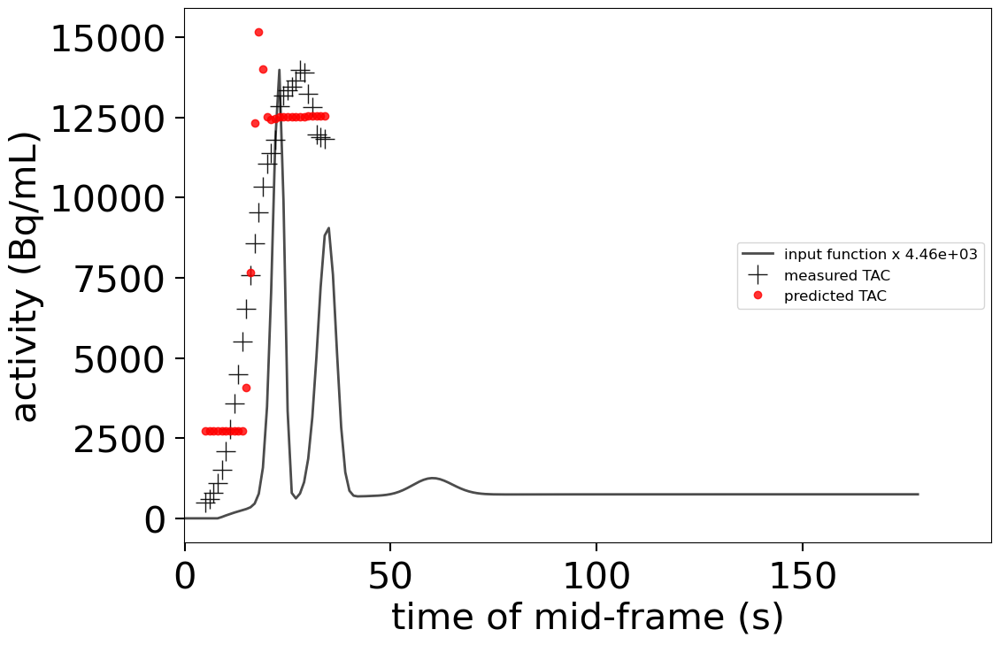

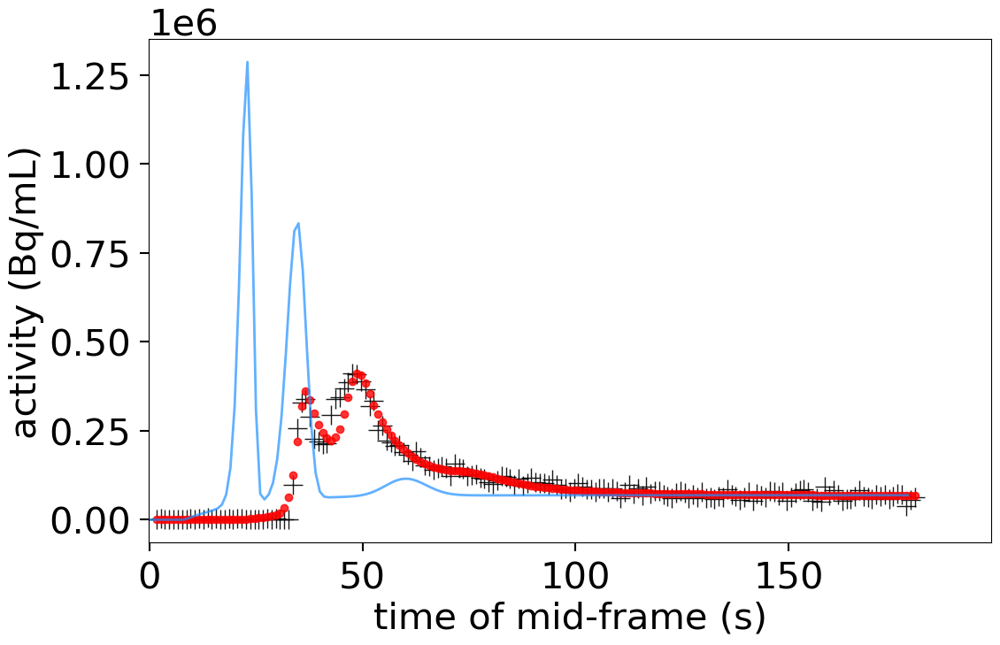

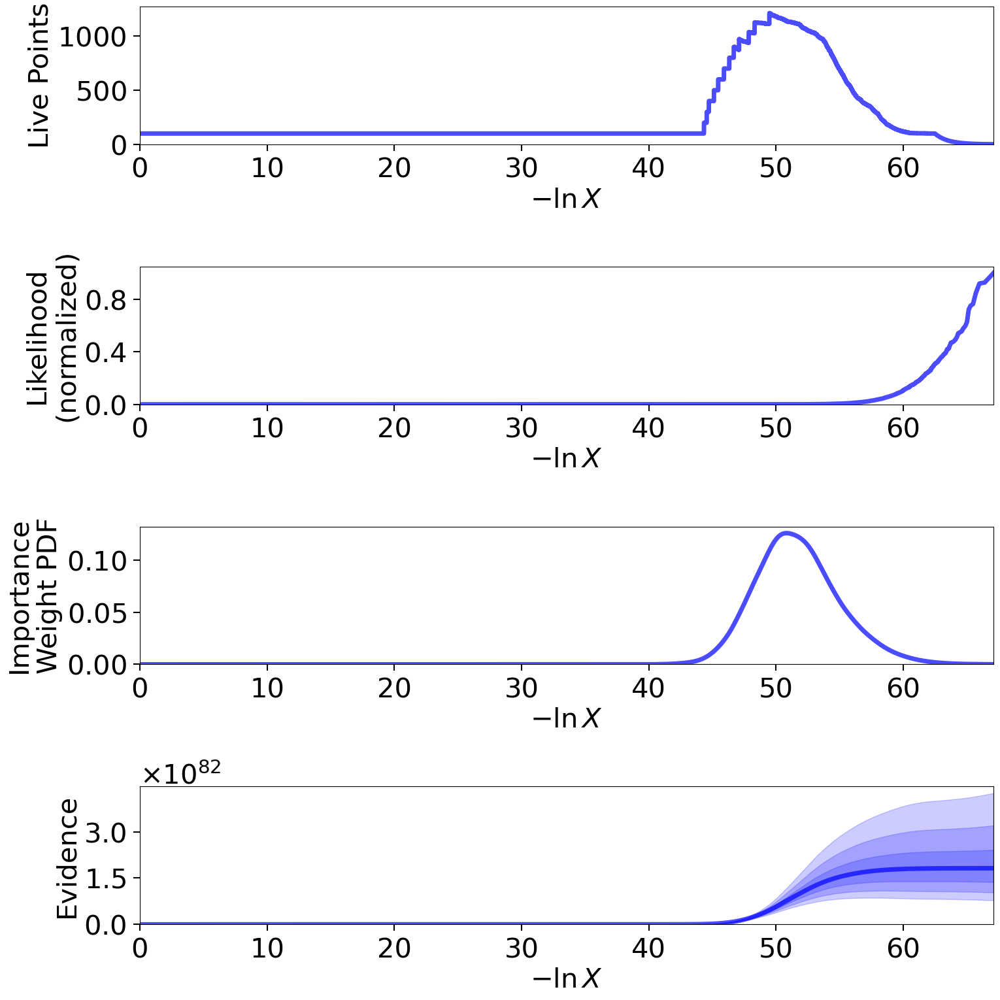

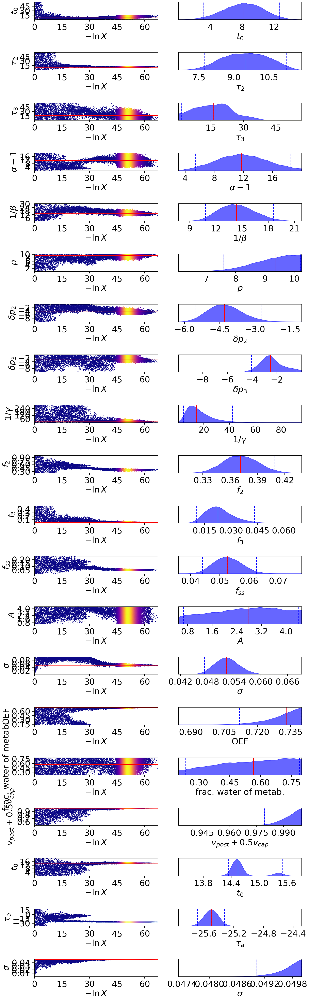

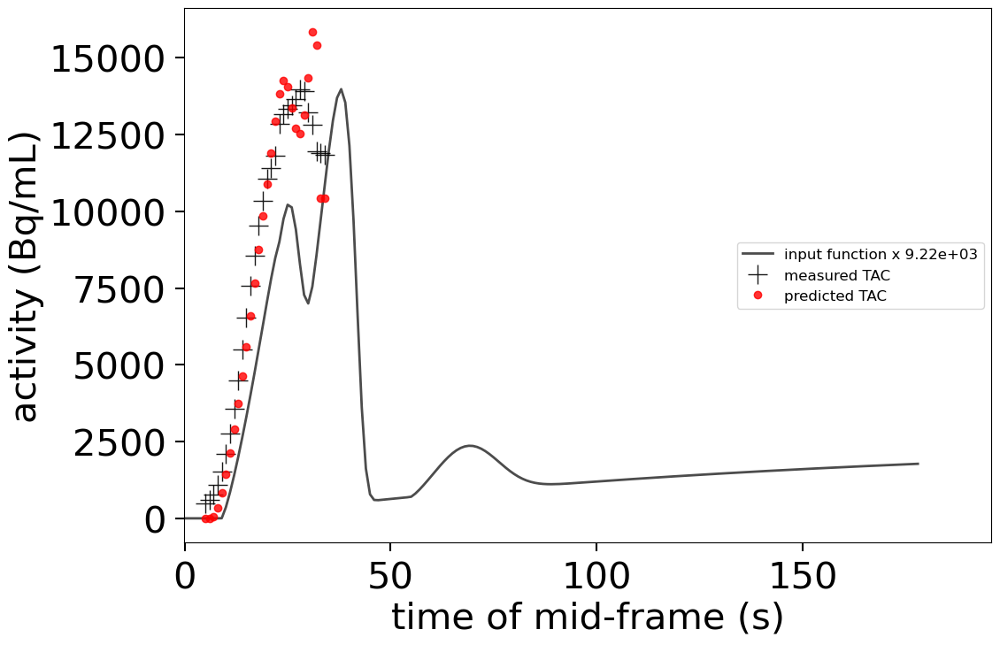

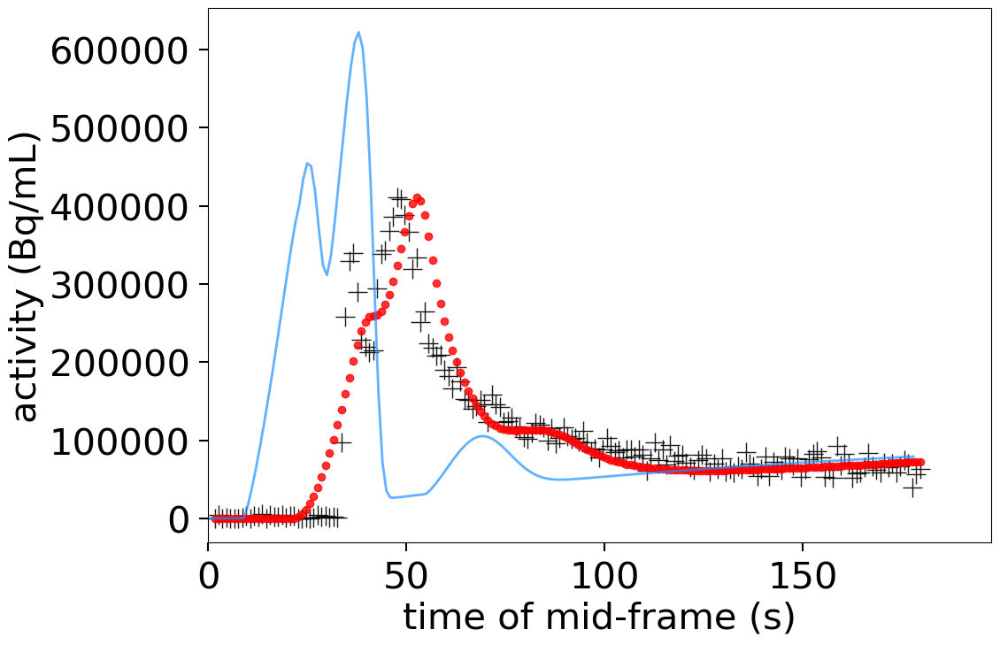

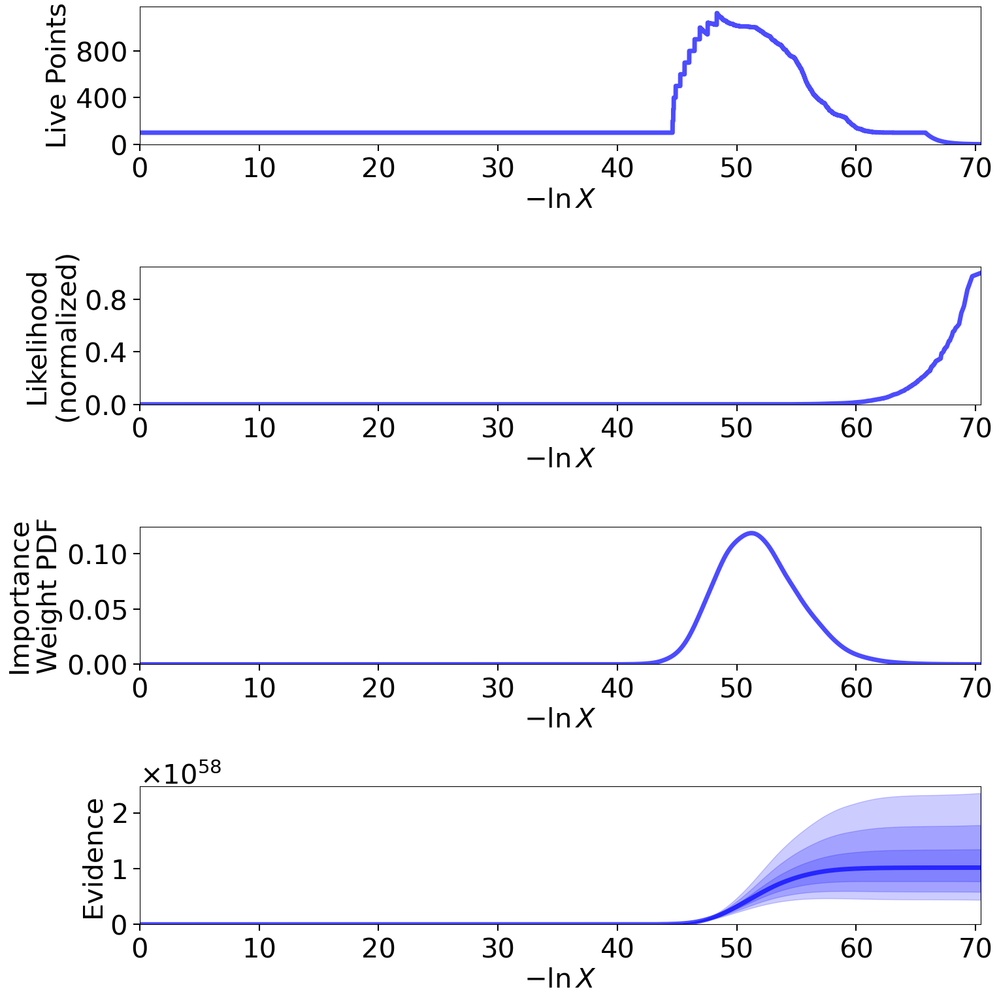

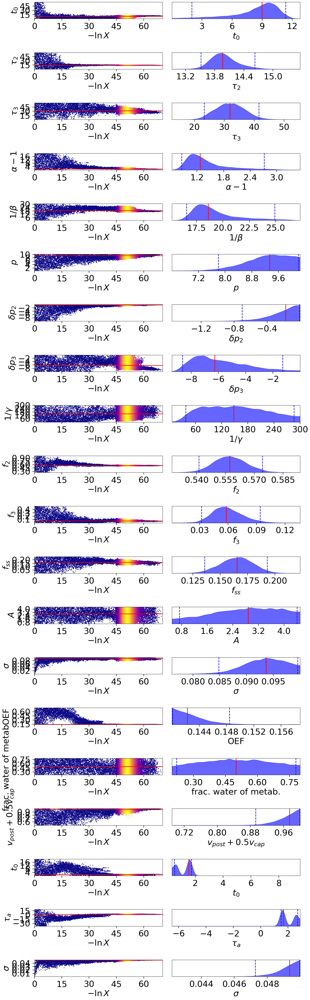

In [8]:
# de novo
res_ra = tcm_ra.run_nested(print_progress=True)

# # restart
# sampler = dynesty.DynamicNestedSampler.restore(tcm_ra.fqfp+"_dynesty-Boxcar-20240122210738.save")
# sampler.run_nested(resume=True, print_progress=True)
# res = sampler.results